nbviewer.jupyter.org/format/slides/gist/leechanwoo/

In [1]:
from IPython.display import Image

# Deep Learning Day 3.

## Tensorflow Basic
 * File I/O using queue runners
 * File I/O using Dataset(TFRecord)

### File I/O using queue runners

 * Dataset Class는 Image read 기능을 직접적으로 제공하지 않기 때문에 하위 레벨 API인 queue runners 활용
 * queue runners는 일종의 thread runner
 * Loading과 Session이 병렬로 동작 $\rightarrow$ Loading delay없이 연속적인 training 가능
 * 디렉토리 내 모든 학습 데이터(image)들을 직접 load하여 train할 경우 유용한 방법

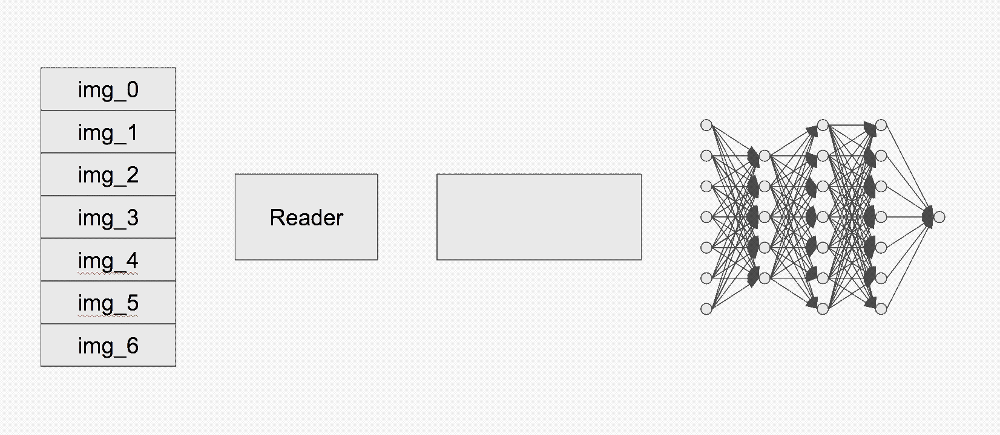

In [2]:
Image('./day3/queue_runners.gif.png')

### $\star$ 데이터를 학습 시키는 두 가지 방법

 * raw data를 로드하여 전처리를 수행 한 후 학습
 
   load $\rightarrow$ preprocessing $\rightarrow$ train

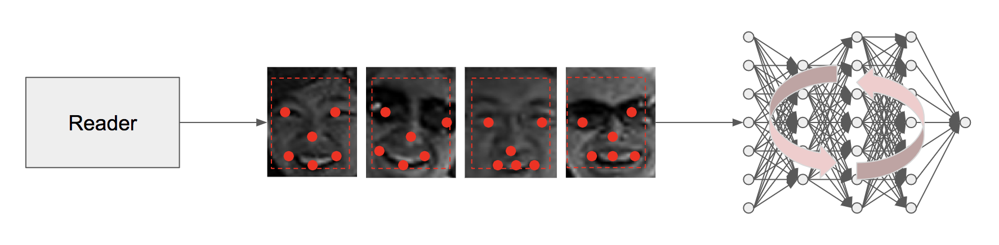

In [3]:
Image('./day3/pipeline1.png')

 * raw data를 모두 전처리하여 파일로 쓰고, 전처리 데이터를 로드하여 학습
    
    load $\rightarrow$ preprocessing $\rightarrow$ write dataset $\rightarrow$ load dataest $\rightarrow$ train

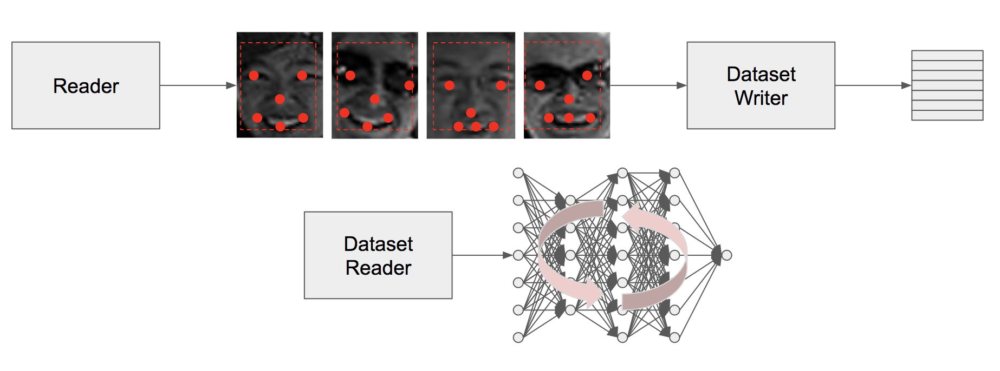

In [4]:
Image('./day3/pipeline2.png')

 * 전처리 라인이 길어질수록 학습 성능 저하
 * 일반적으로 전처리 파이프라인을 별도로 운영하고, 전처리가 완료된 dataset을 트레인 데이터로 활용
 * 각 데이터 포맷 별로 to tfrecord transformer를 구축하여 트레인 시스템 운영 권장

### File I/O using Dataset(TFRecord)

 * Tensorflow에서 권장하는 record dataset
 * csv와 유사하게 Dataset 클래스로 쉽게 데이터 로드 가능
 * 실제로 File Load는 한 번 이루어지므로 효율적인 data read 가능
 * HDFS 활용 시 매우 효과적

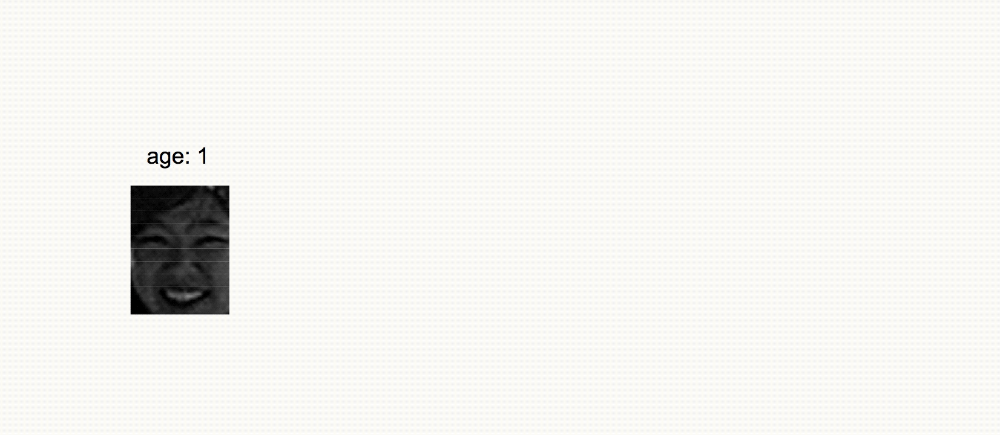

In [5]:
Image('./day3/transform_tfrecord.gif.png')

### Implementation

In [1]:
import tensorflow as tf
import os

image_dir = './cnn_dataset/dataset_img'
age_dir = './cnn_dataset/dataset_age/age.csv'
imgname_list = [os.path.join(image_dir, n) for n in os.listdir(image_dir)]

imgname_queue = tf.train.string_input_producer(imgname_list, num_epochs=1, shuffle=False, )
agename_queue= tf.train.string_input_producer([age_dir], shuffle=False)

img_reader = tf.WholeFileReader()
age_reader = tf.TextLineReader()

_, raw_img = img_reader.read(imgname_queue)
_, raw_age = age_reader.read(agename_queue)

decoded_img = tf.image.decode_png(raw_img)
decoded_age = tf.decode_csv(raw_age, [[0]])

reshaped_img = tf.reshape(decoded_img, [-1])

In [2]:
with tf.Session() as sess:
    coord = tf.train.Coordinator()
    thread = tf.train.start_queue_runners(sess, coord)
    sess.run(tf.local_variables_initializer())

    face_train_dir = './cnn_dataset/face_train.tfrecord'
    face_test_dir = './cnn_dataset/face_test.tfrecord'
    
    train_writer = tf.python_io.TFRecordWriter(face_train_dir)
    test_writer = tf.python_io.TFRecordWriter(face_test_dir)
    
    for i in range(99999999):
        try:
            _age, _img = sess.run([decoded_age, reshaped_img])

            example = tf.train.Example()
            example.features.feature['age'].int64_list.value.append(_age[0])
            example.features.feature['img'].int64_list.value.extend(_img.tolist())

            if i < 6000:
                train_writer.write(example.SerializeToString())
                if i%500 == 0:
                    print('{} train data written'.format(i))
            else:
                test_writer.write(example.SerializeToString())
                if i%500 == 0:
                    print('{} test data written'.format(i))

        except tf.errors.OutOfRangeError:
            print('size of total dataset {}'.format(i))
            break
            
    train_writer.close()
    test_writer.close()
    
    coord.request_stop()
    coord.join(thread)

0 train data written
500 train data written
1000 train data written
1500 train data written
2000 train data written
2500 train data written
3000 train data written
3500 train data written
4000 train data written
4500 train data written
5000 train data written
5500 train data written
6000 test data written
6500 test data written
7000 test data written
7500 test data written
size of total dataset 7533


In [3]:
import tensorflow as tf
import matplotlib.pyplot as plt
%matplotlib inline


def parser(serialized_example):
    features = {
        'age': tf.FixedLenFeature([1], tf.int64),
        'img': tf.FixedLenFeature([61*49], tf.int64)
    }
    
    parsed_feature = tf.parse_single_example(serialized_example, features)
    age = parsed_feature['age']
    img = parsed_feature['img']
    return age, img

face_train = './cnn_dataset/face_train.tfrecord'
face_test = './cnn_dataset/face_test.tfrecord'

train_dataset = tf.contrib.data.TFRecordDataset(face_train).map(parser)
train_dataset = train_dataset.batch(1)

test_dataset = tf.contrib.data.TFRecordDataset(face_test).map(parser)
test_dataset = test_dataset.batch(1)

itr = tf.contrib.data.Iterator.from_structure(train_dataset.output_types, train_dataset.output_shapes)
age, img = itr.get_next()

training_init_op = itr.make_initializer(train_dataset)
test_init_op = itr.make_initializer(test_dataset)


print('img shape {}'.format(img.shape))
img = tf.reshape(img, [-1, 61, 49])


with tf.Session() as sess:
    sess.run(tf.global_variables_initializer())
    sess.run(tf.local_variables_initializer())

    sess.run(training_init_op)
    for train_step in range(999999):
        try:
            train_img = sess.run(img)

        except tf.errors.OutOfRangeError:
            print('size of train dataset {}'.format(train_step))
            break

    sess.run(test_init_op)
    for test_step in range(9999999):
        try:
            test_img = sess.run(img)

        except tf.errors.OutOfRangeError:
            print('size of test dataset {}'.format(test_step))
            break

img shape (?, 2989)
size of train dataset 6000
size of test dataset 1533
